# Objective

Visualize the current results of the luminoth Faster RCNN model as of Nov. 6, 2020.

# Dataset

35 images: all 25 images from what I call 'set_2' plus 10 images from 'set_1' where the locations are very close to the spots


# Takeaways

Filtering for predicted spots with a prediction value > ~0.995 results in a predicted_spot_count/actual_spot_count ratio close to 1, images that were produced in October (according to their names). This makes sense because I only trained the model on October images. I am now going through and fixing the annotations for some September images to add them to the training set. (At the time I originally annotated these, I only cared about getting counts so some of the click marks are imprecise.) Hopefully this will give more consistent performance in the September images, and hopefully further tuning of hyperparameters will tighten all the curves together.

Counting takes about 2 or 3 minutes per image.

# Next steps

Train the model afresh with
- a training set including images from September and October
- adjusted hyperparameters

Test the model on all annotated images (especially the test set, but also including the training set for sanity).

In [113]:
from skimage.io import imread
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.lines import Line2D
from os import listdir

In [124]:
files = listdir('./images/')
names = []
for file in files:
    names.append(file[:-4])


--------------------------------------------

image-cropped-rescaled-20200916-201111-6


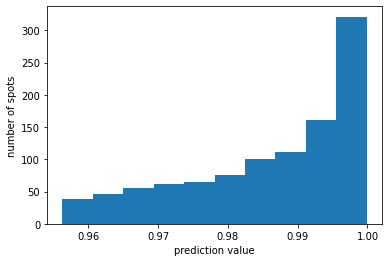

count ground_truth:       756
count prediction > 0.98:  739


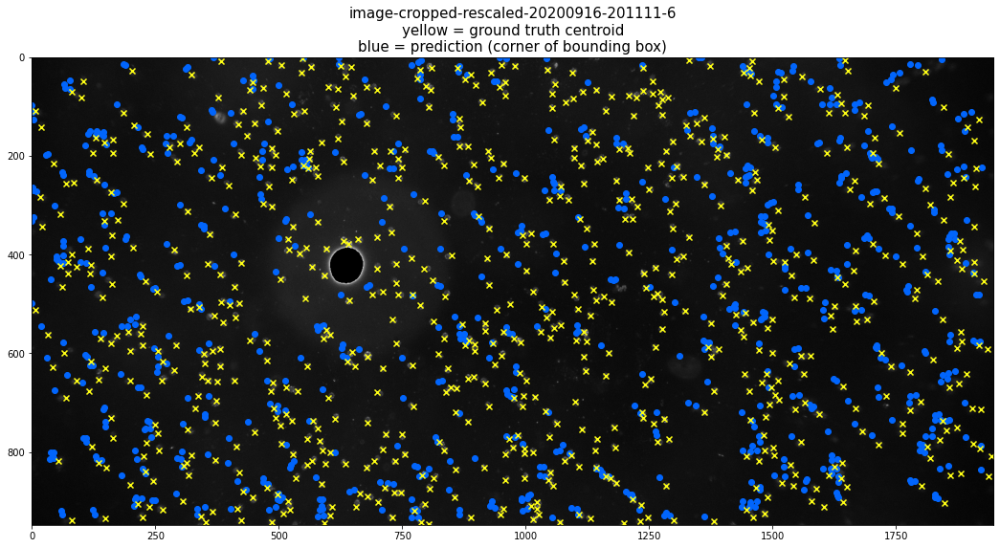


--------------------------------------------

image-cropped-rescaled-20201002-142245-3


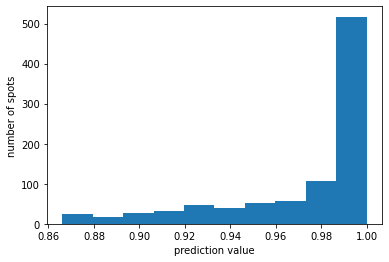

count ground_truth:       382
count prediction > 0.98:  580


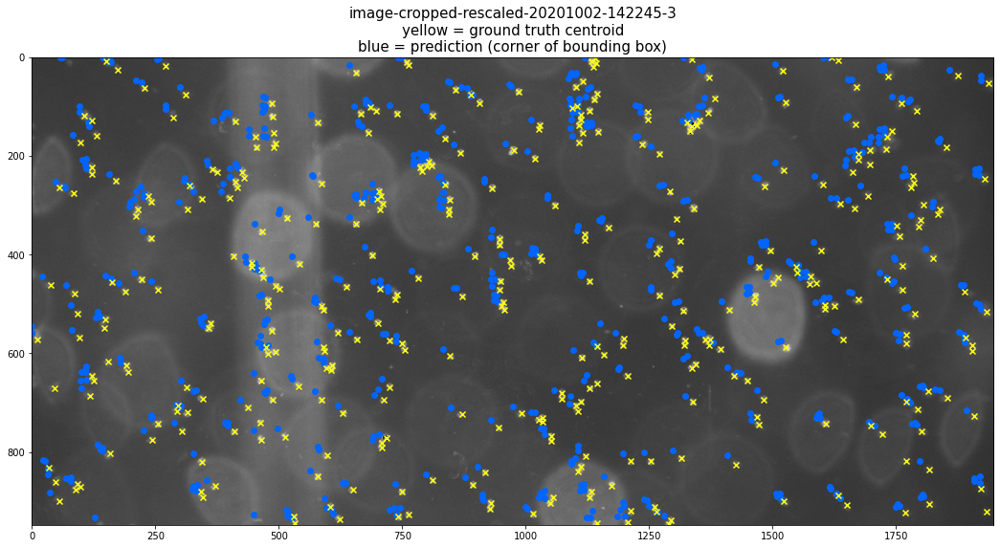


--------------------------------------------

image-cropped-rescaled-20200901-194356-2


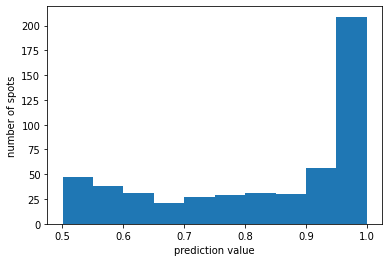

count ground_truth:       120
count prediction > 0.98:  154


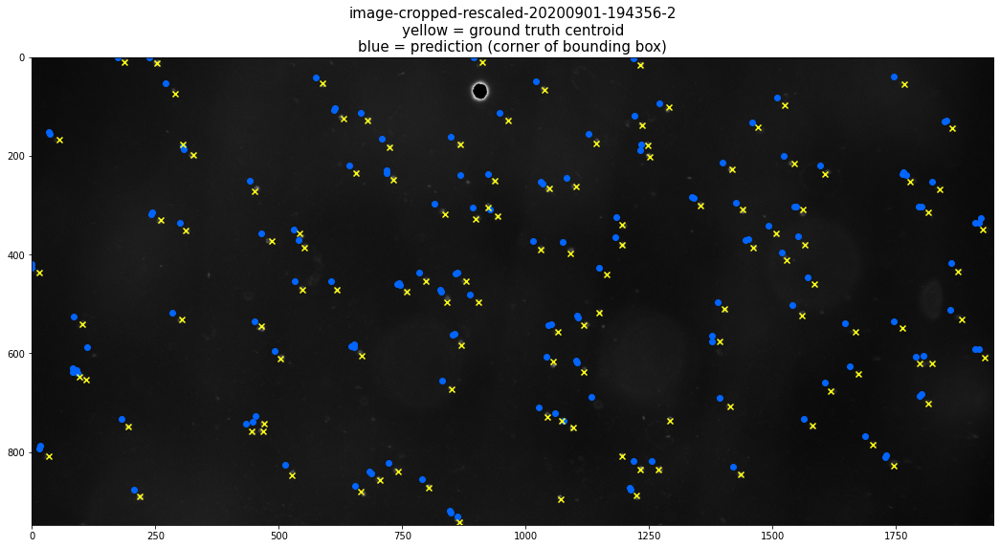


--------------------------------------------

image-cropped-rescaled-20201002-145125-5


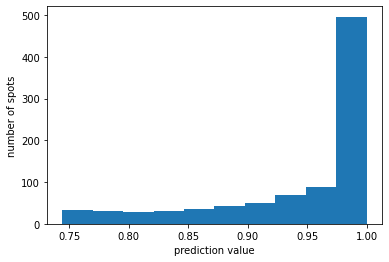

count ground_truth:       321
count prediction > 0.98:  469


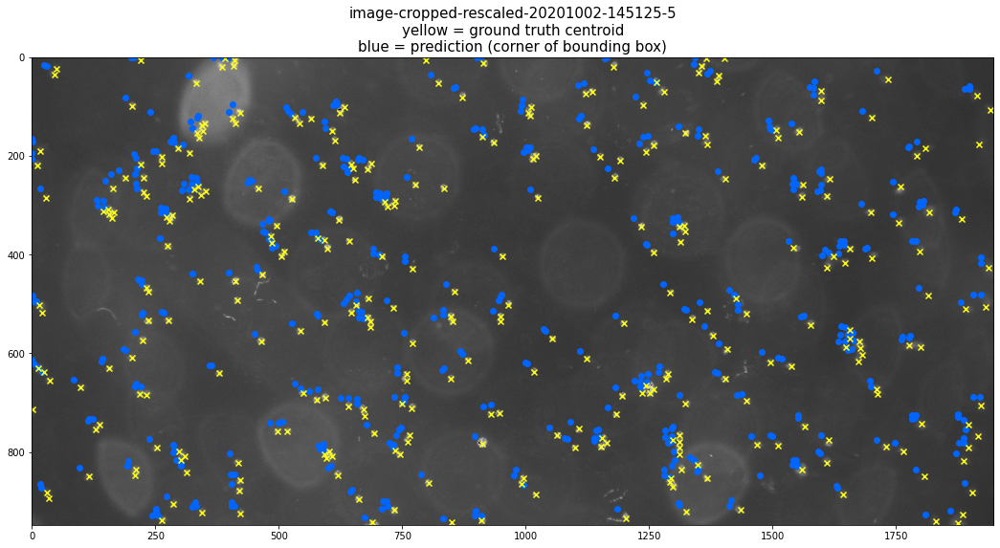


--------------------------------------------

image-cropped-rescaled-20200916-200824-5


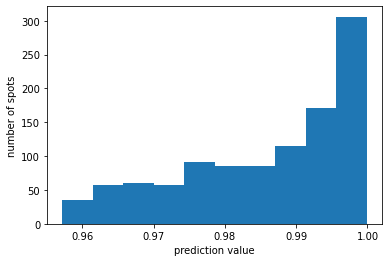

count ground_truth:       847
count prediction > 0.98:  738


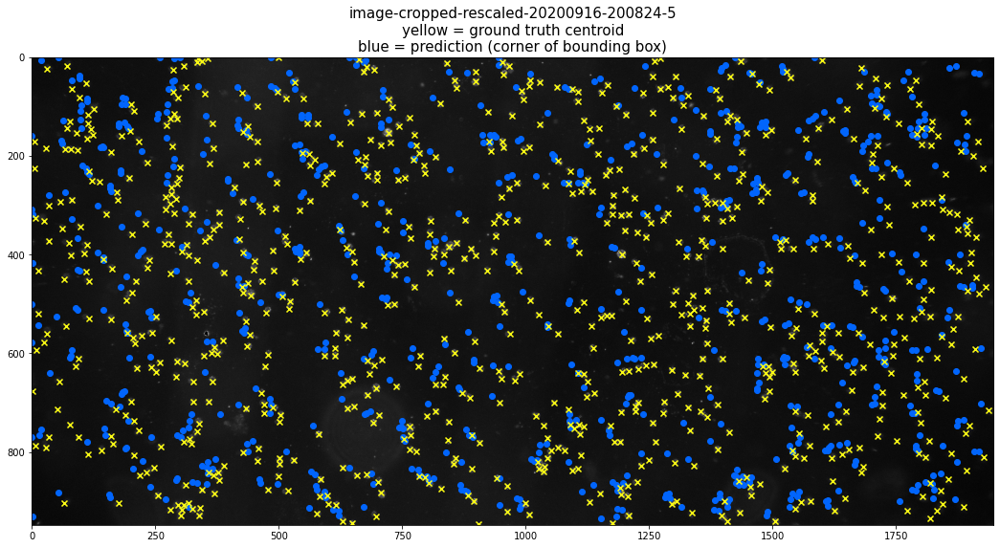


--------------------------------------------

image-cropped-rescaled-20200901-193823-1


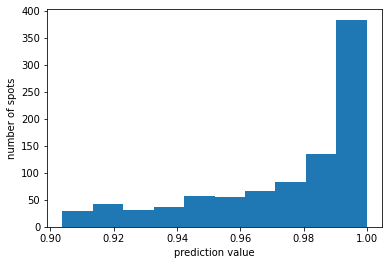

count ground_truth:       450
count prediction > 0.98:  521


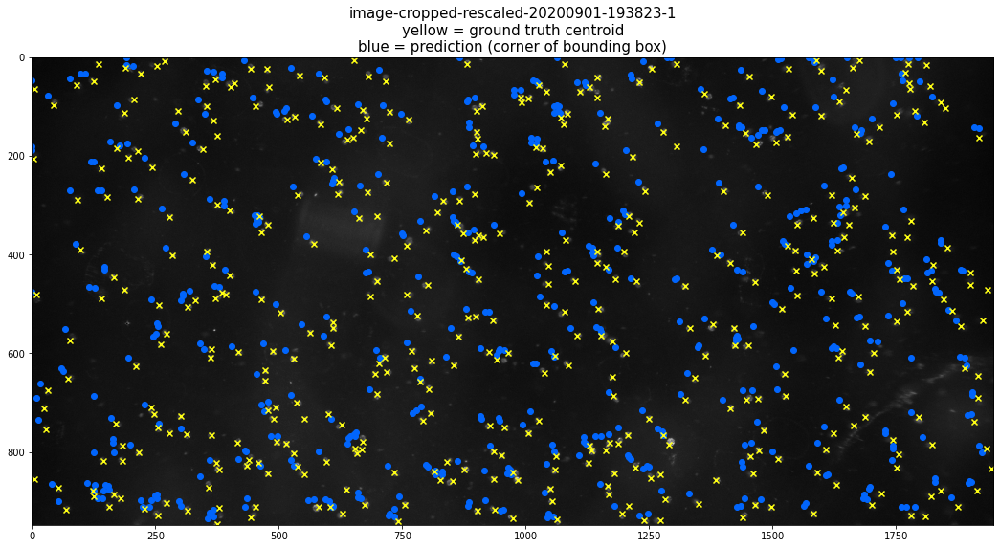


--------------------------------------------

image-cropped-rescaled-20201002-125630-2


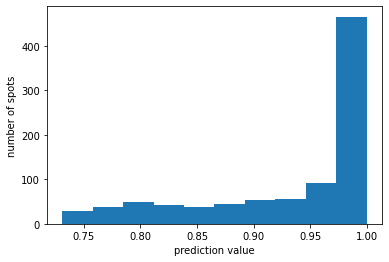

count ground_truth:       326
count prediction > 0.98:  431


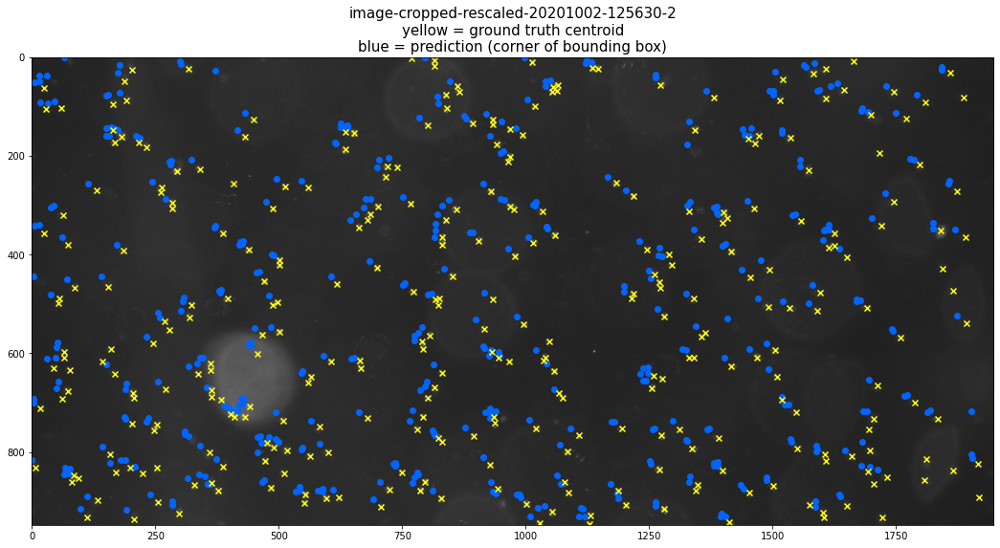


--------------------------------------------

image-cropped-rescaled-20201002-150536-4


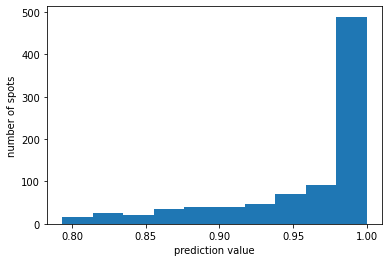

count ground_truth:       338
count prediction > 0.98:  485


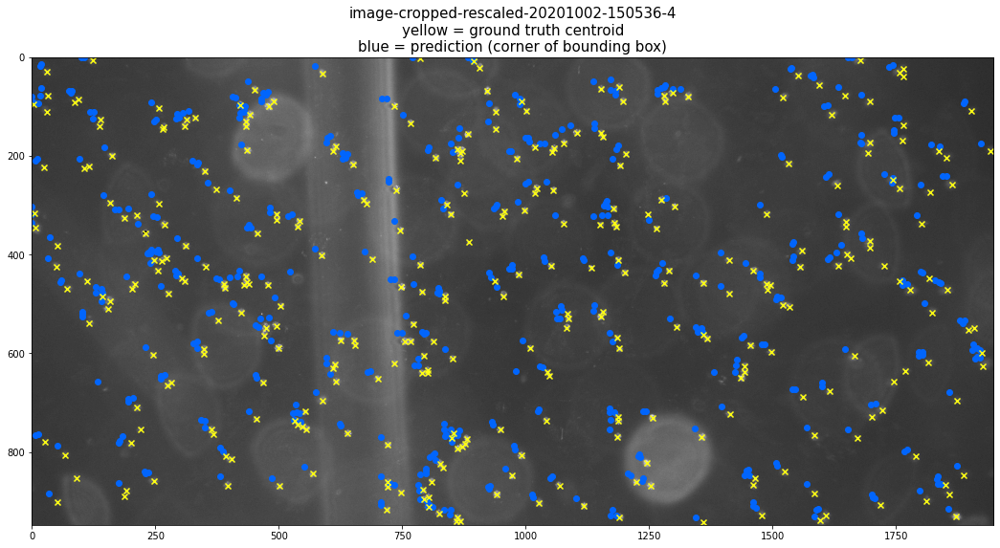


--------------------------------------------

image-cropped-rescaled-20201002-142245-6


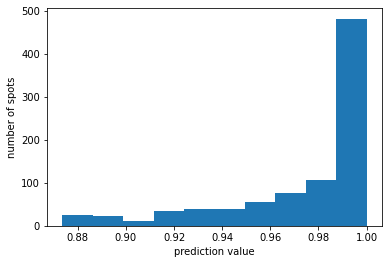

count ground_truth:       369
count prediction > 0.98:  552


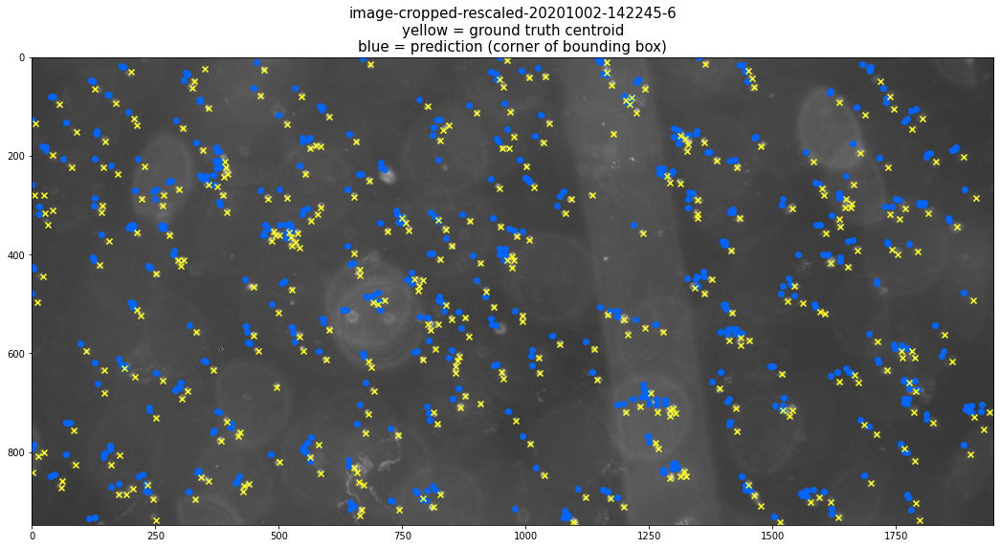


--------------------------------------------

image-cropped-rescaled-20201002-150536-6


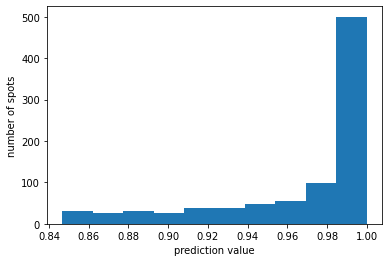

count ground_truth:       364
count prediction > 0.98:  536


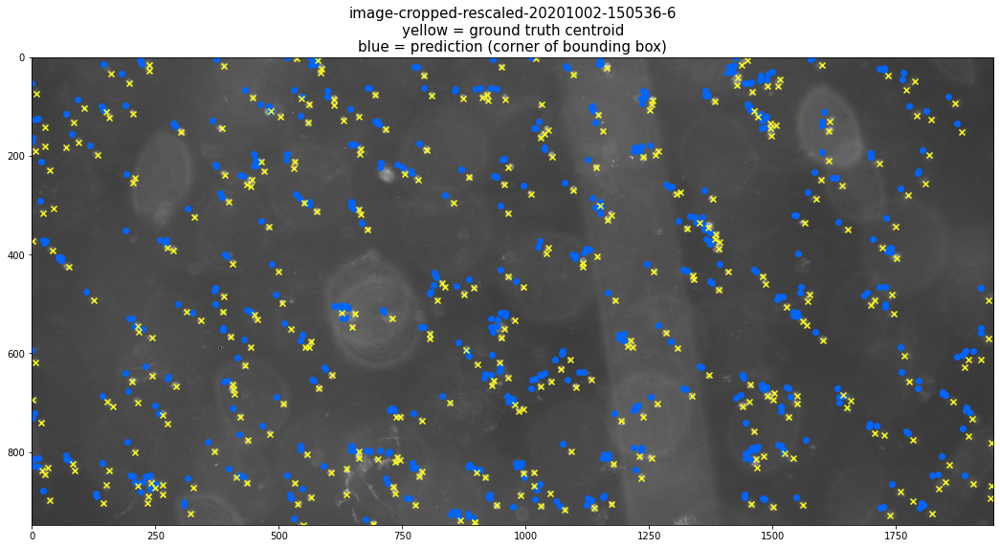


--------------------------------------------

image-cropped-rescaled-20201002-132522-1


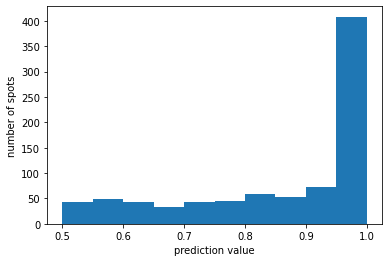

count ground_truth:       219
count prediction > 0.98:  316


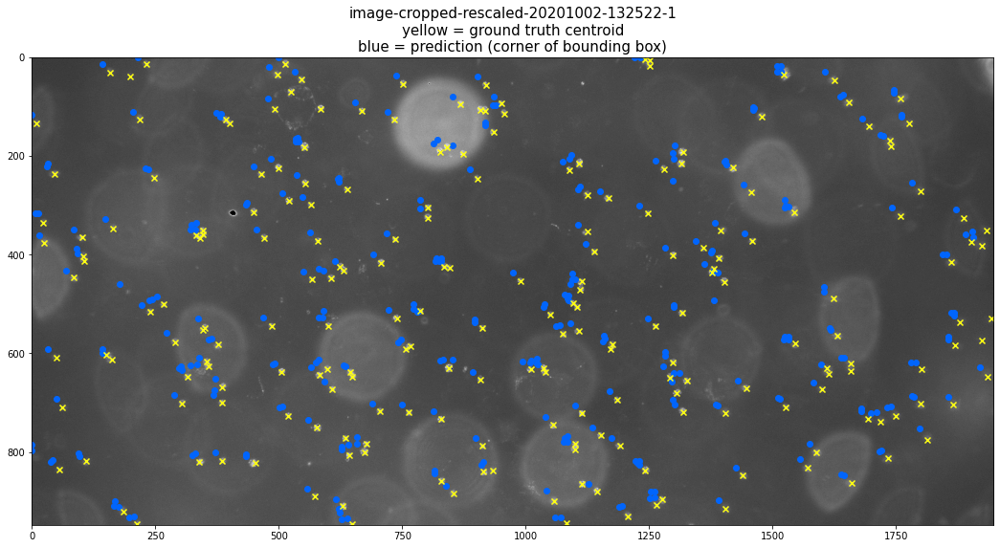


--------------------------------------------

image-cropped-rescaled-20200916-200538-0


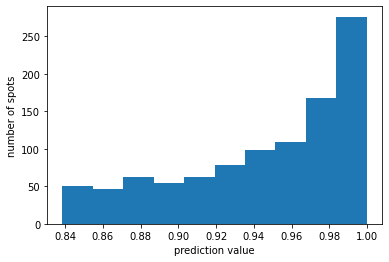

count ground_truth:       658
count prediction > 0.98:  316


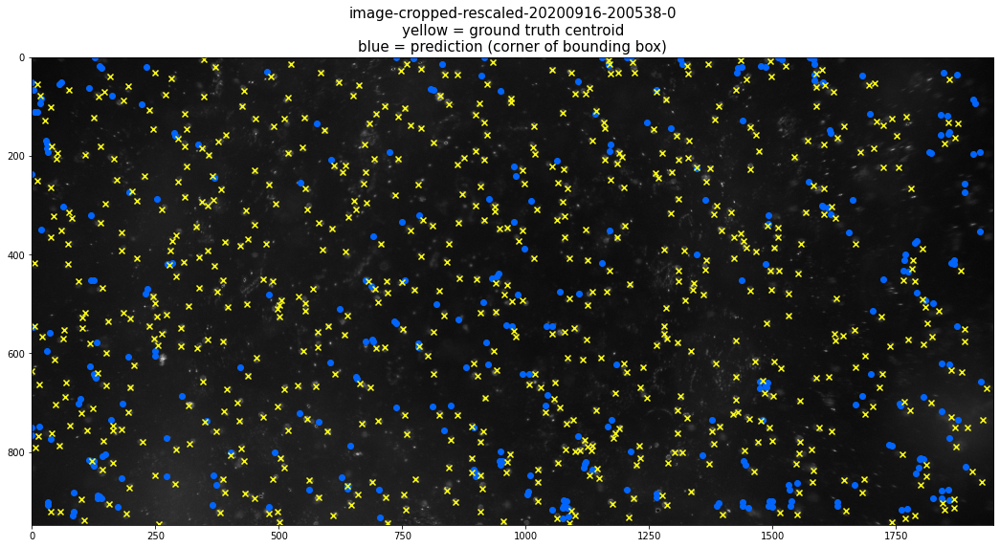


--------------------------------------------

image-cropped-rescaled-20200901-194109-1


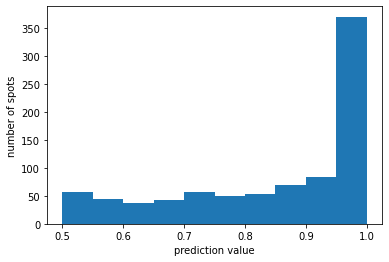

count ground_truth:       188
count prediction > 0.98:  274


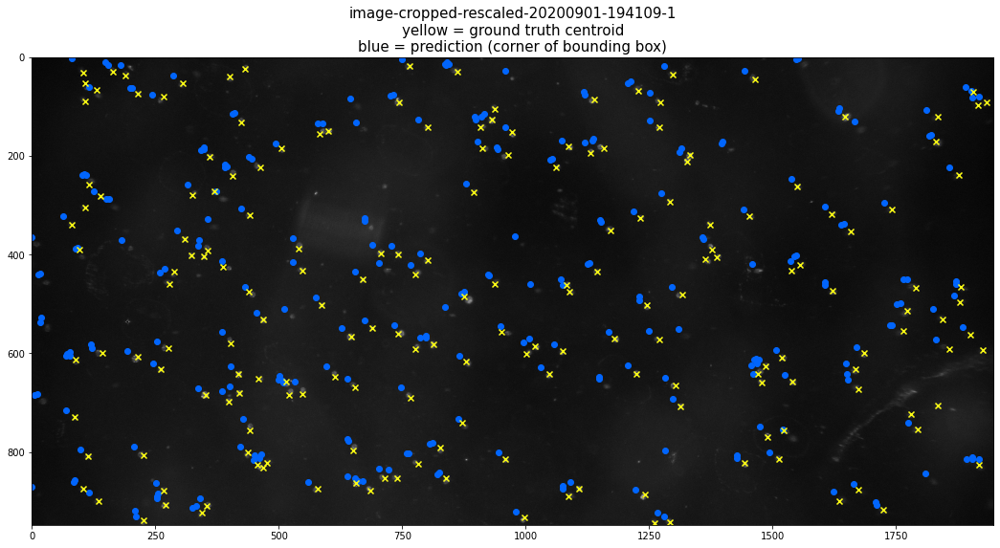


--------------------------------------------

image-cropped-rescaled-20201002-135404-7


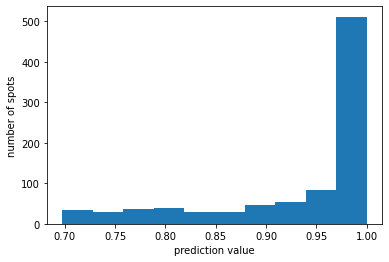

count ground_truth:       321
count prediction > 0.98:  464


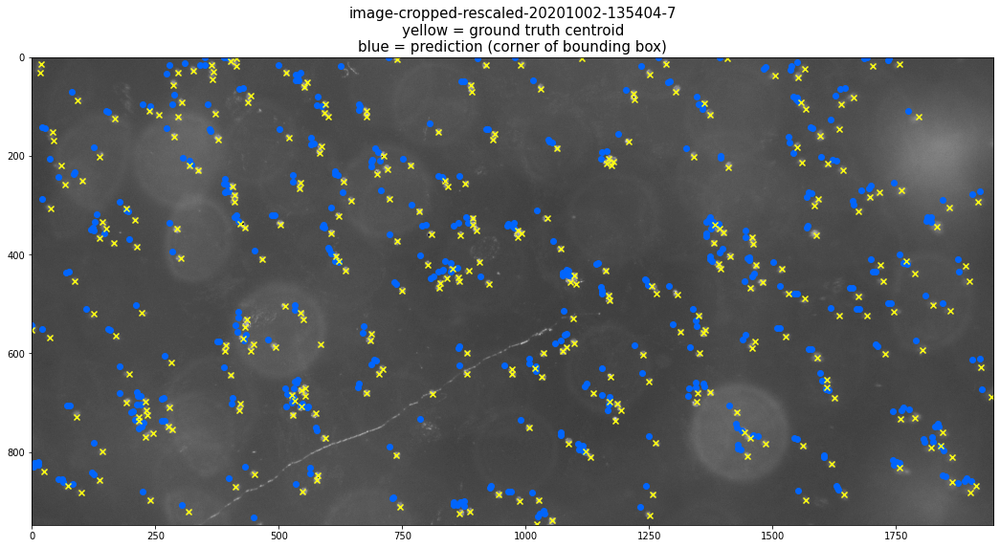


--------------------------------------------

image-cropped-rescaled-20201002-125630-4


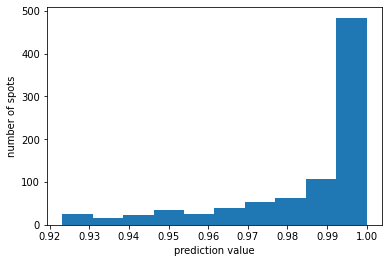

count ground_truth:       450
count prediction > 0.98:  634


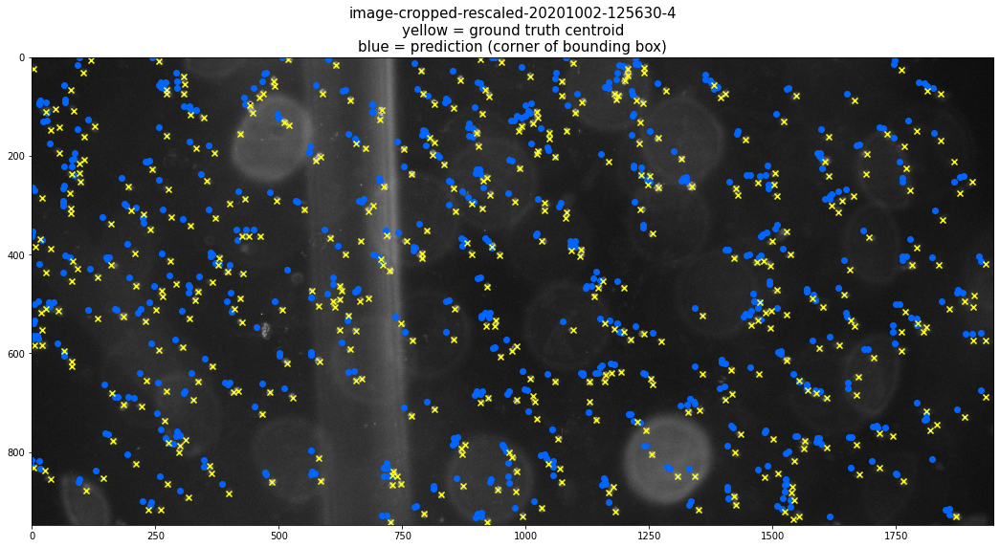


--------------------------------------------

image-cropped-rescaled-20200916-200538-7


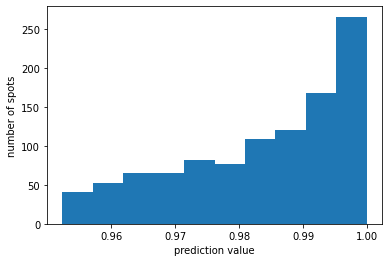

count ground_truth:       1010
count prediction > 0.98:  674


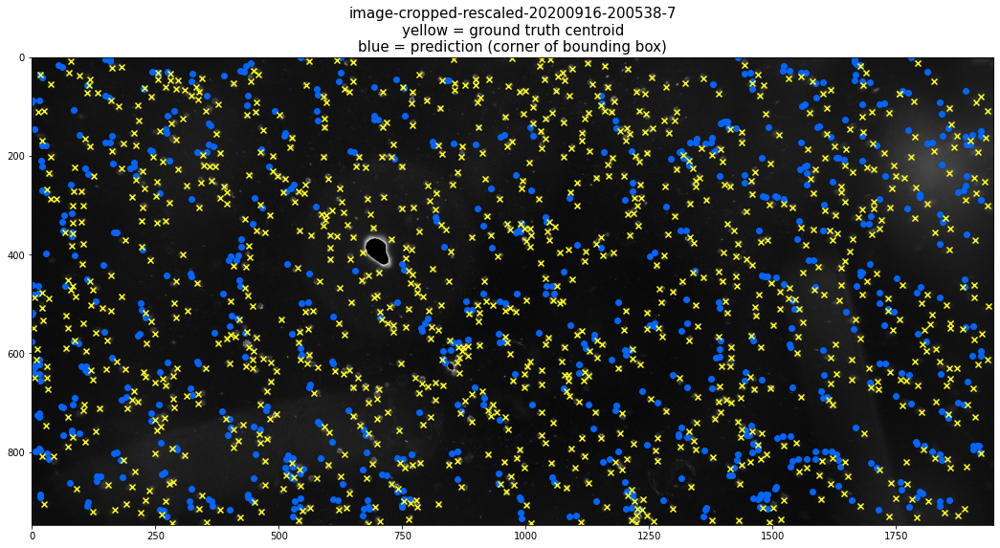


--------------------------------------------

image-cropped-rescaled-20200901-193536-0


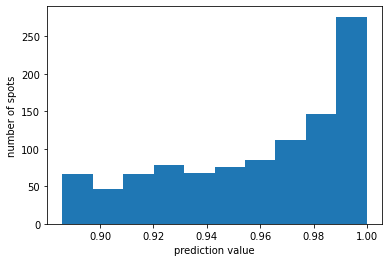

count ground_truth:       944
count prediction > 0.98:  391


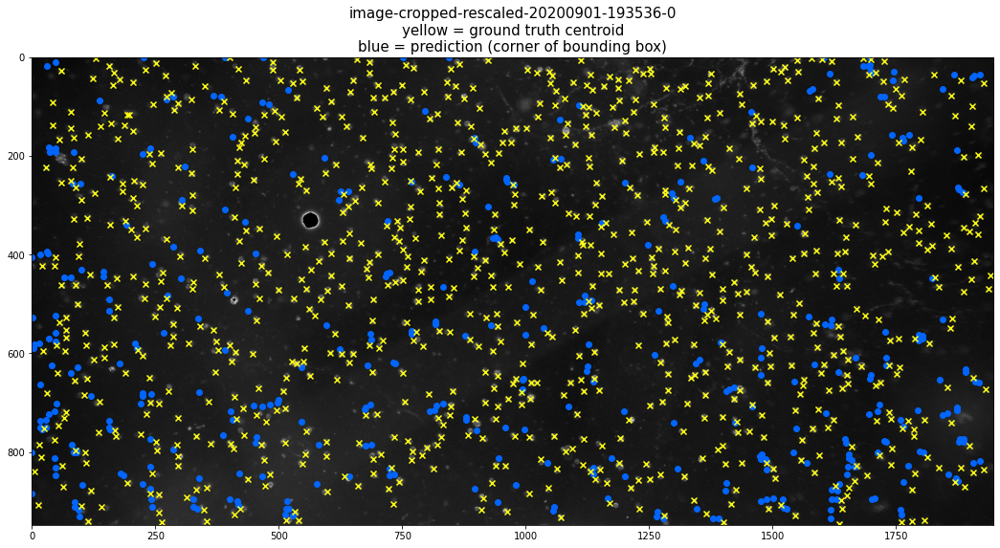


--------------------------------------------

image-cropped-rescaled-20201002-142245-4


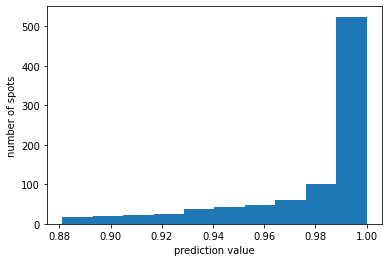

count ground_truth:       419
count prediction > 0.98:  601


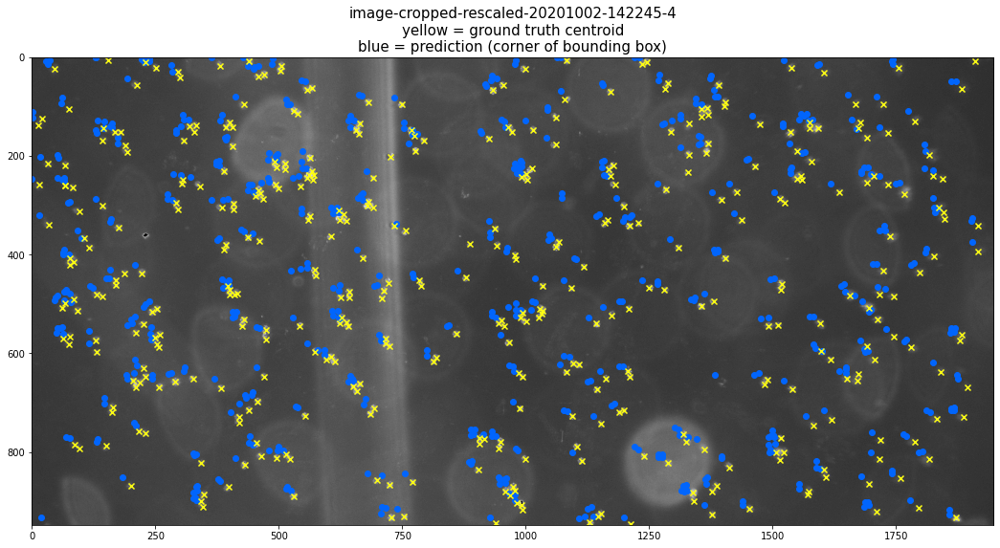


--------------------------------------------

image-cropped-rescaled-20200916-201111-5


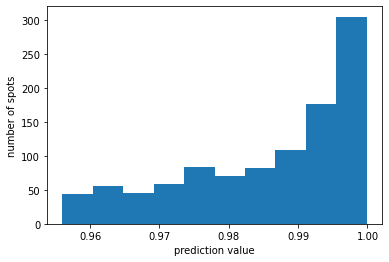

count ground_truth:       804
count prediction > 0.98:  705


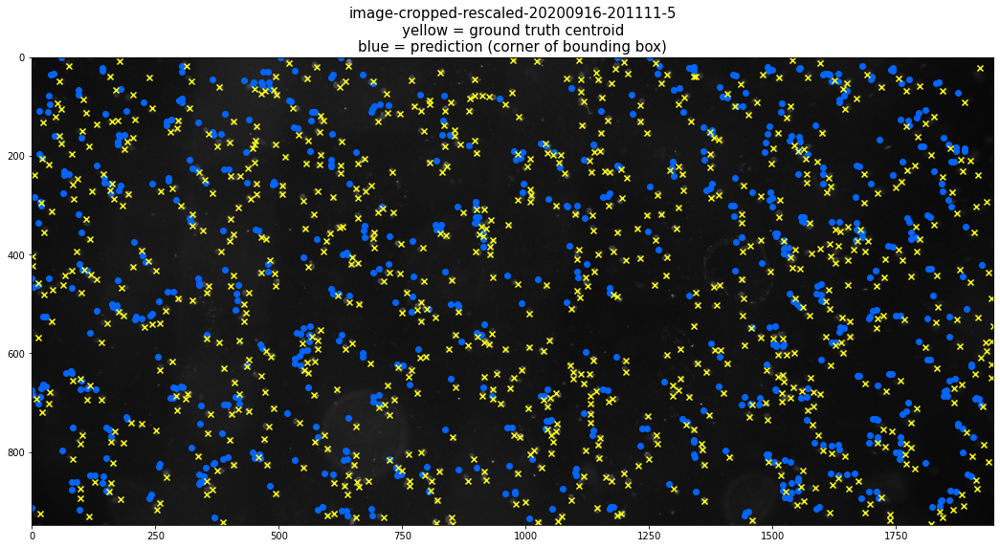


--------------------------------------------

image-cropped-rescaled-20201002-145125-4


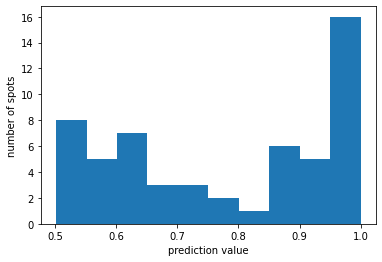

count ground_truth:       4
count prediction > 0.98:  8


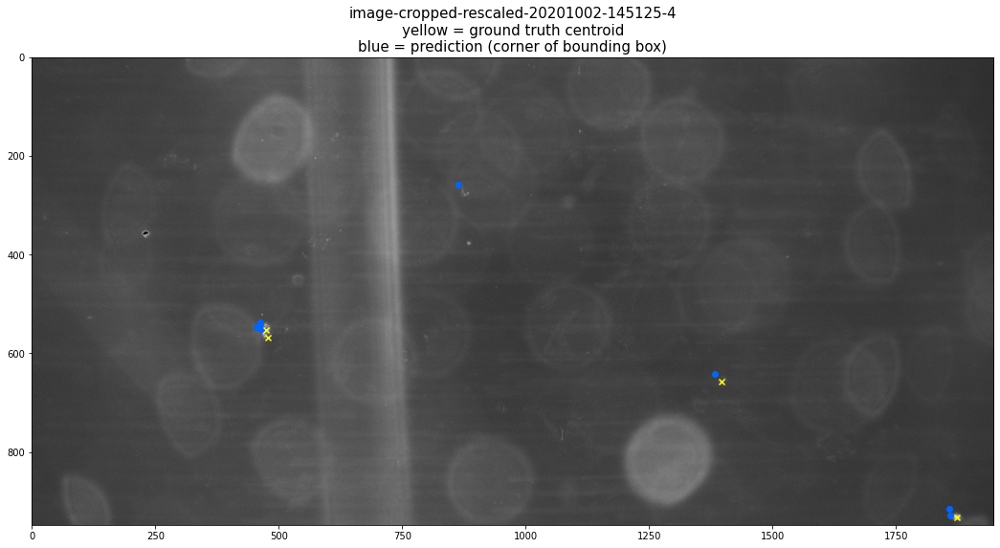


--------------------------------------------

image-cropped-rescaled-20201002-135404-1


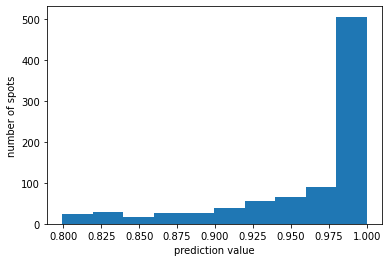

count ground_truth:       292
count prediction > 0.98:  506


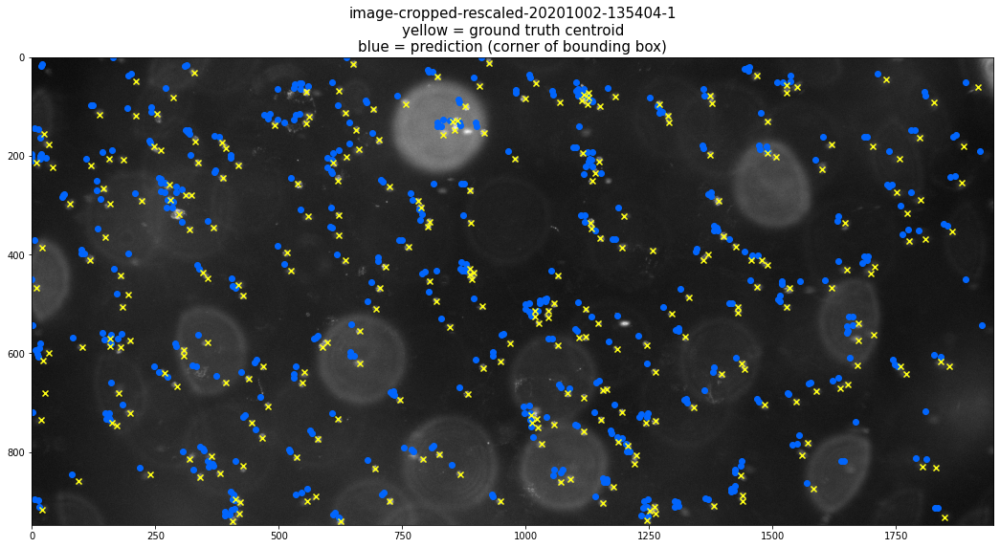


--------------------------------------------

image-cropped-rescaled-20201002-142245-2


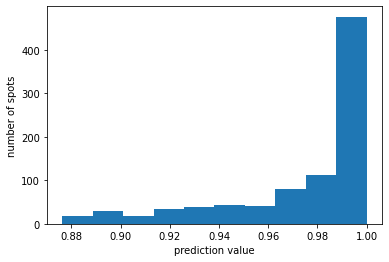

count ground_truth:       380
count prediction > 0.98:  556


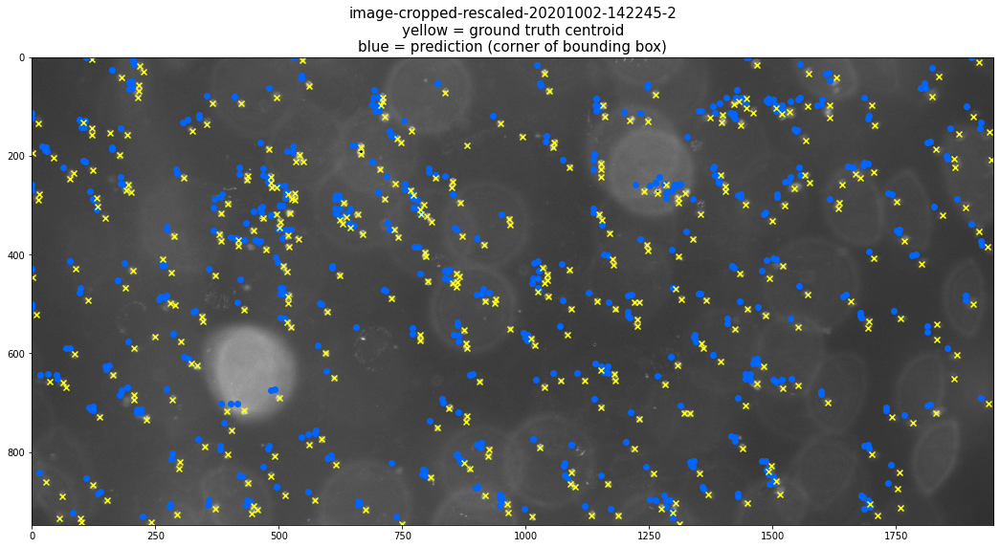


--------------------------------------------

image-cropped-rescaled-20200901-193823-3


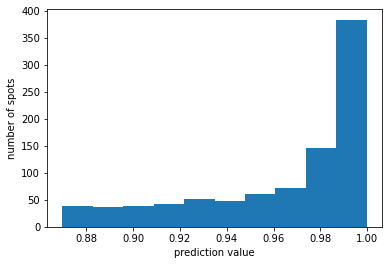

count ground_truth:       448
count prediction > 0.98:  466


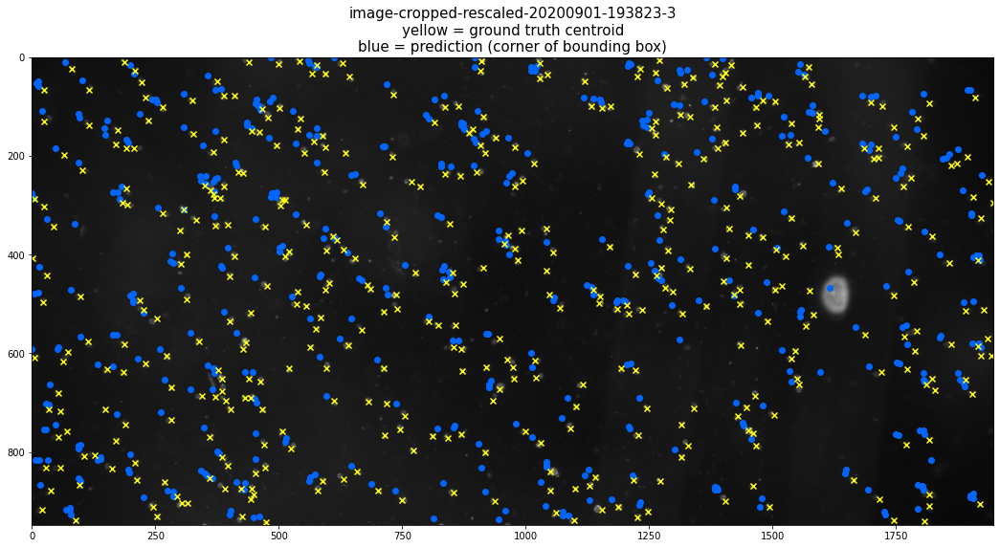


--------------------------------------------

image-cropped-rescaled-20201002-145125-3


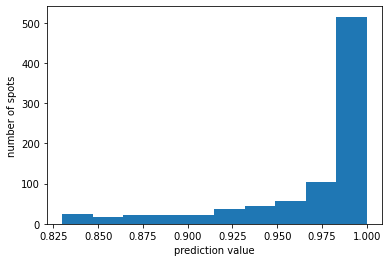

count ground_truth:       367
count prediction > 0.98:  535


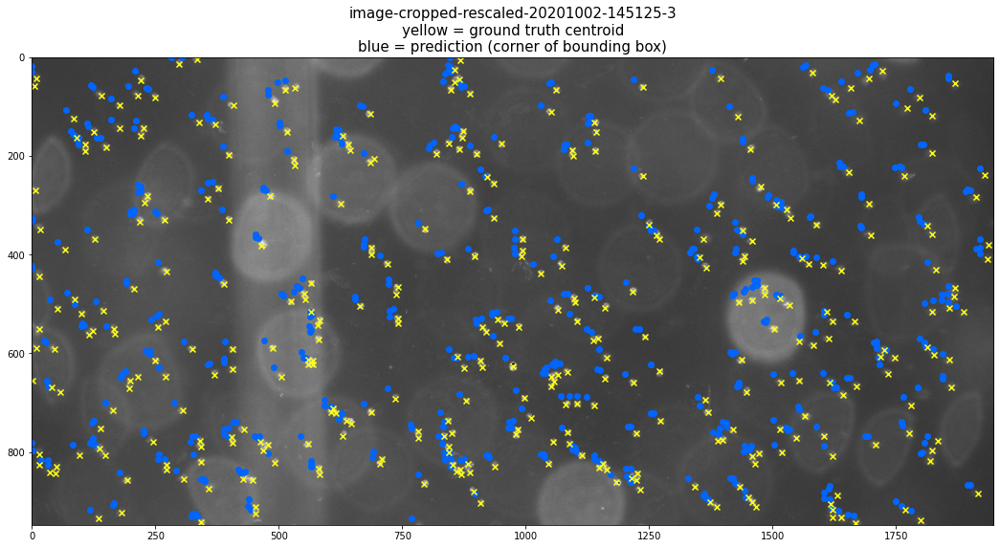


--------------------------------------------

image-cropped-rescaled-20201002-131101-7


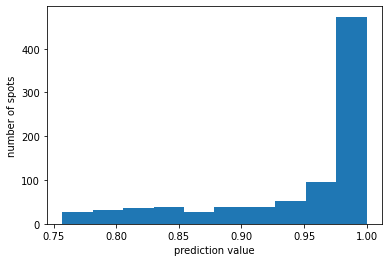

count ground_truth:       297
count prediction > 0.98:  451


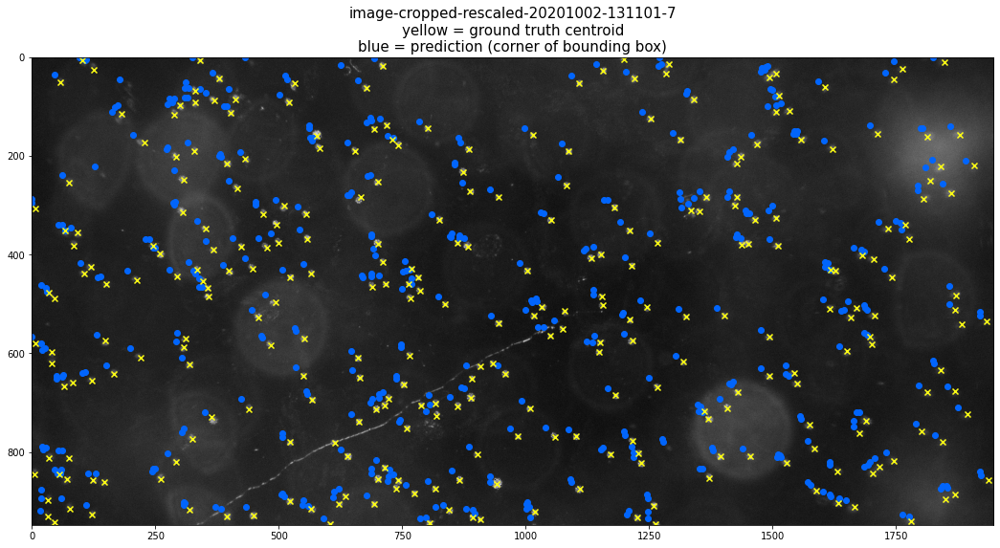


--------------------------------------------

image-cropped-rescaled-20201002-132522-6


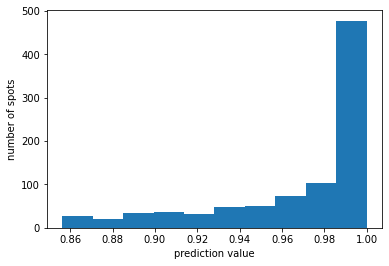

count ground_truth:       338
count prediction > 0.98:  527


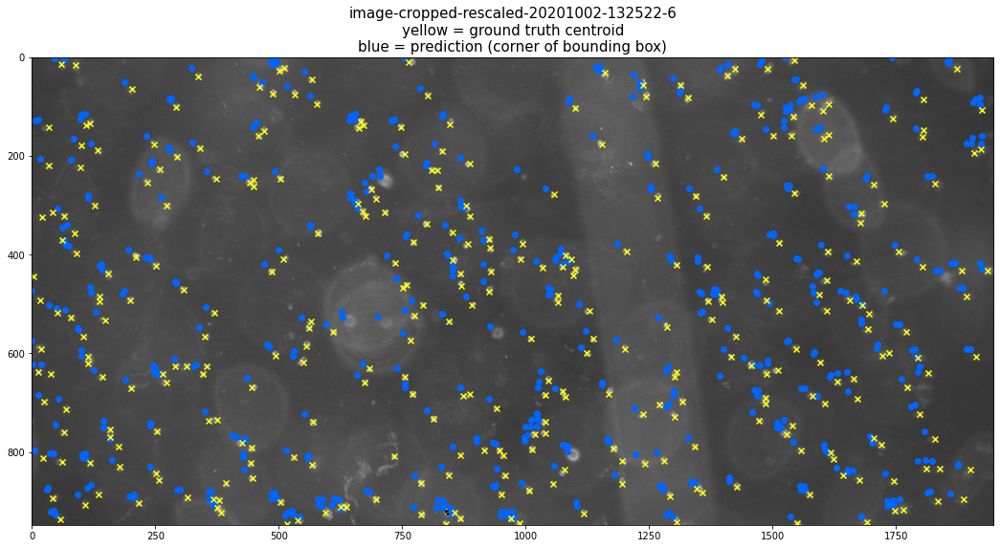


--------------------------------------------

image-cropped-rescaled-20201002-140824-4


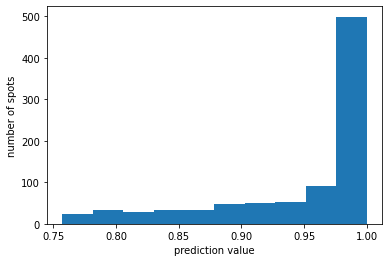

count ground_truth:       305
count prediction > 0.98:  474


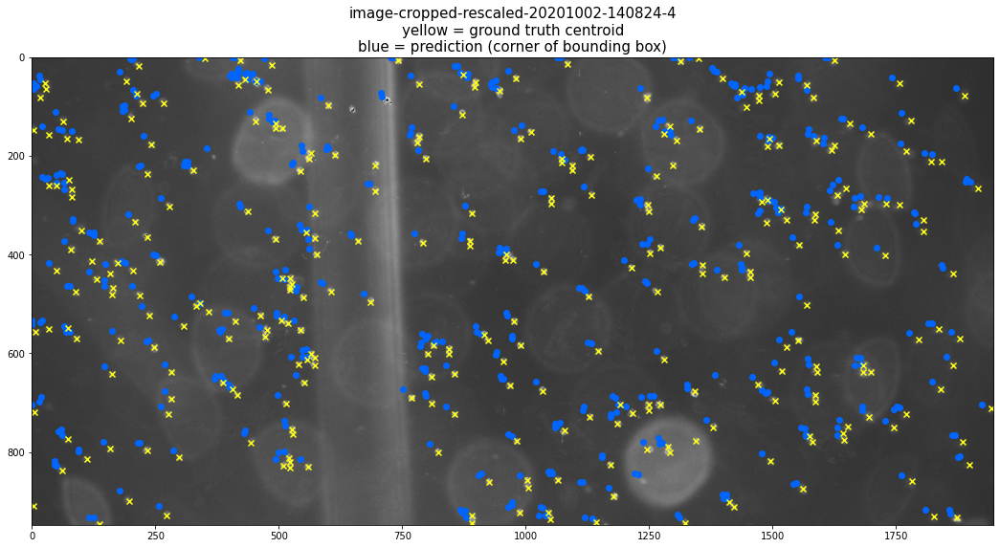


--------------------------------------------

image-cropped-rescaled-20201002-133942-4


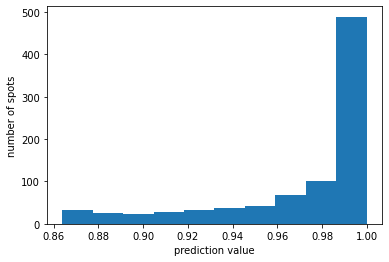

count ground_truth:       355
count prediction > 0.98:  551


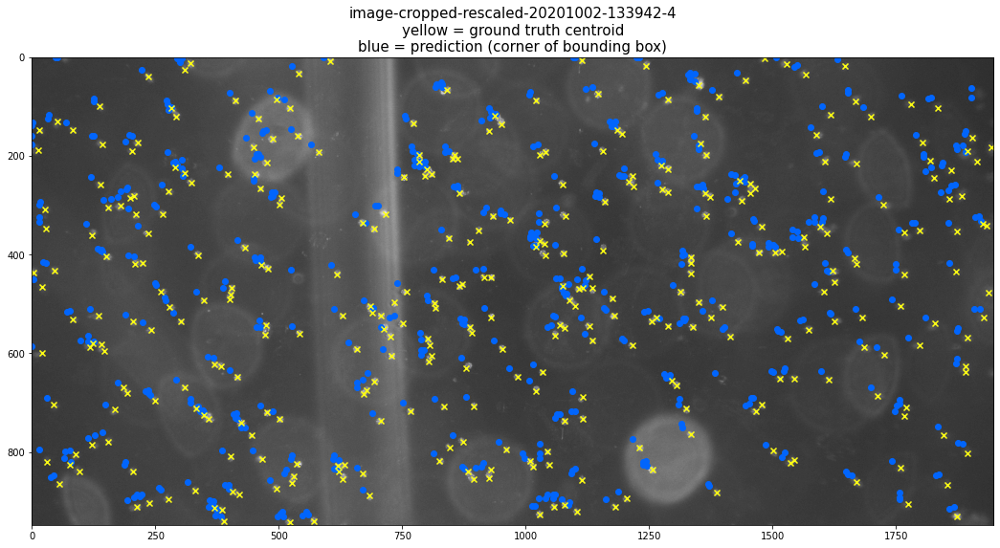


--------------------------------------------

image-cropped-rescaled-20201002-125630-7


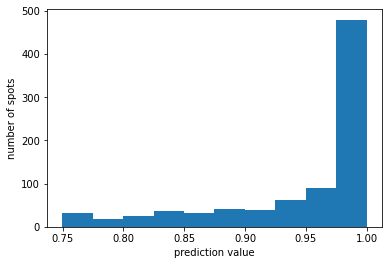

count ground_truth:       318
count prediction > 0.98:  453


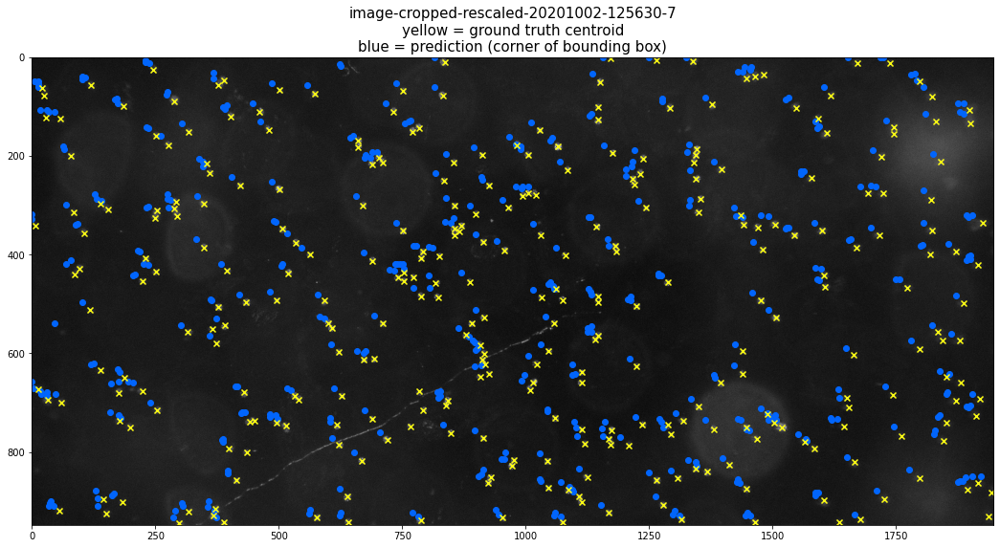


--------------------------------------------

image-cropped-rescaled-20201002-131101-4


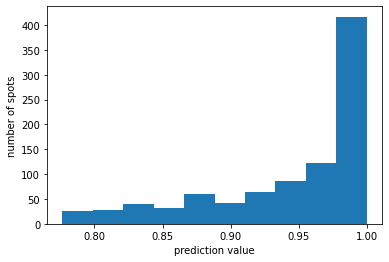

count ground_truth:       340
count prediction > 0.98:  395


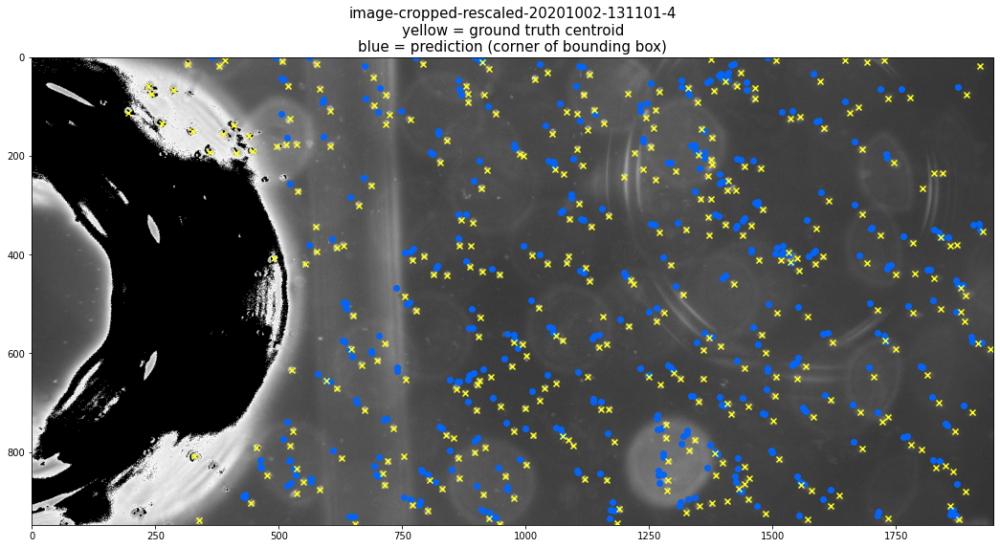


--------------------------------------------

image-cropped-rescaled-20201002-143706-5


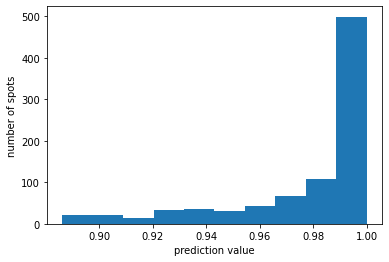

count ground_truth:       356
count prediction > 0.98:  581


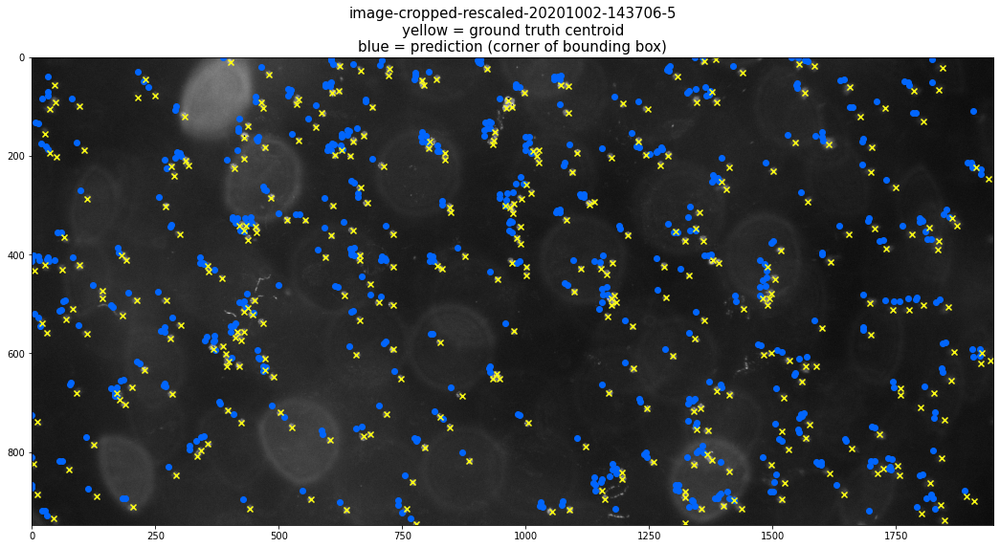


--------------------------------------------

image-cropped-rescaled-20201002-145125-0


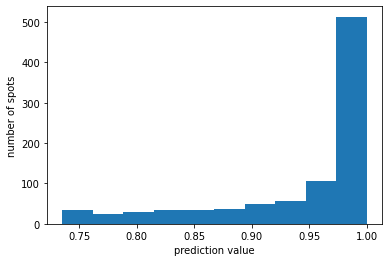

count ground_truth:       336
count prediction > 0.98:  483


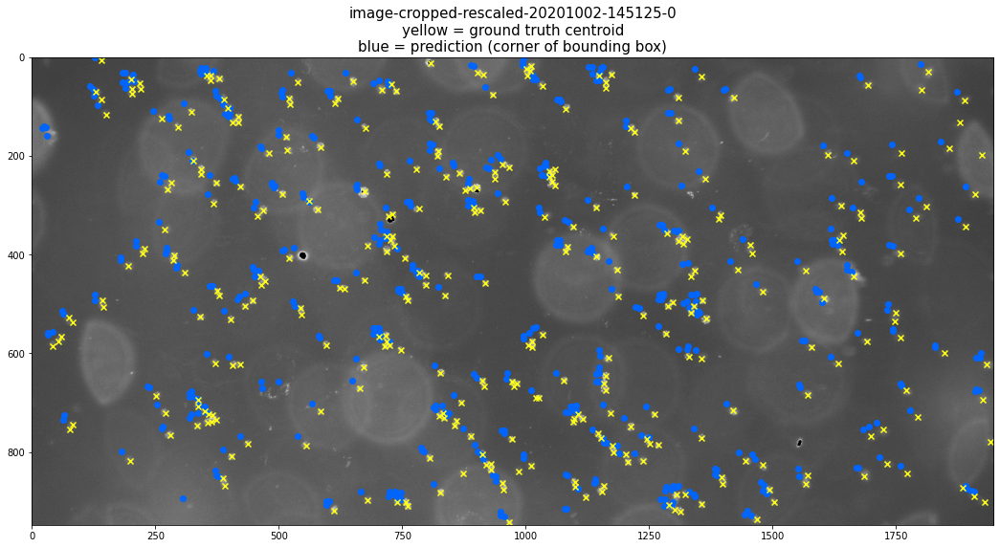


--------------------------------------------

image-cropped-rescaled-20201002-150536-1


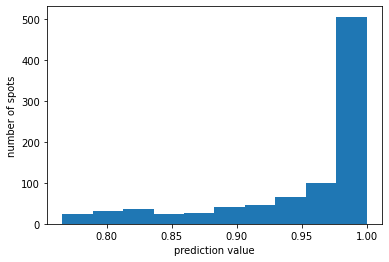

count ground_truth:       345
count prediction > 0.98:  493


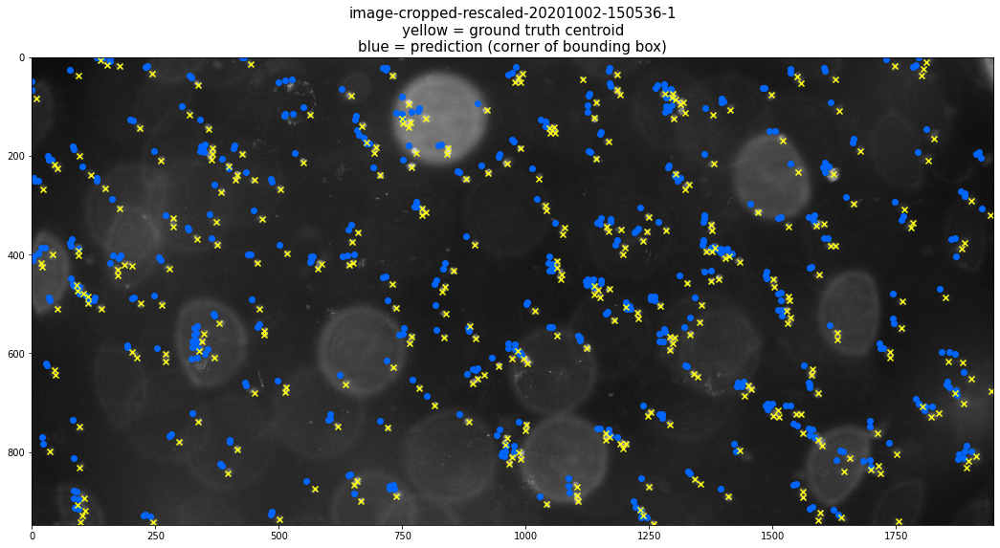


--------------------------------------------

image-cropped-rescaled-20201002-150536-7


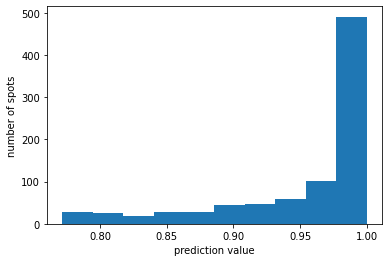

count ground_truth:       330
count prediction > 0.98:  477


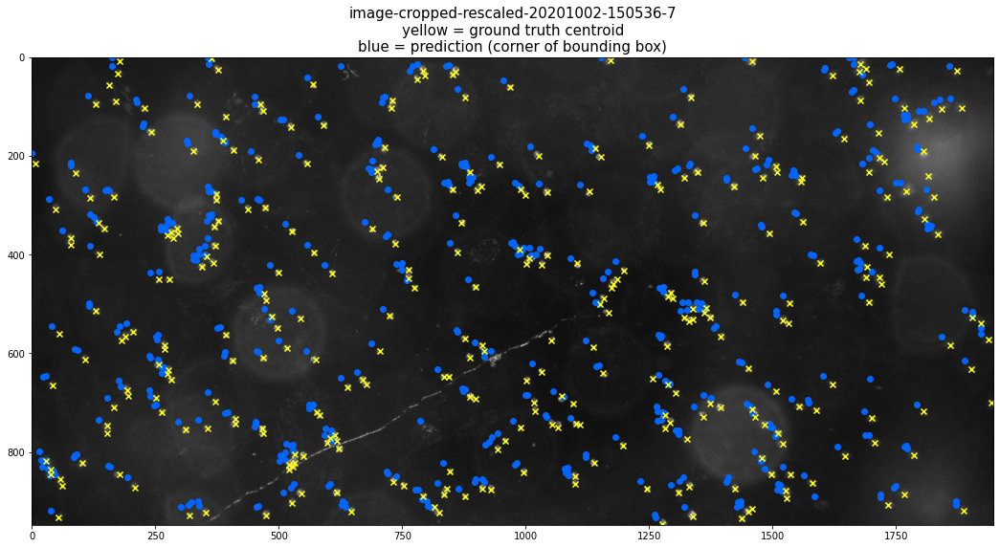


--------------------------------------------

image-cropped-rescaled-20201002-135404-2


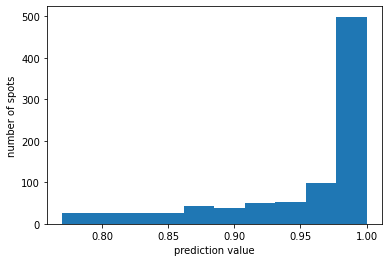

count ground_truth:       322
count prediction > 0.98:  478


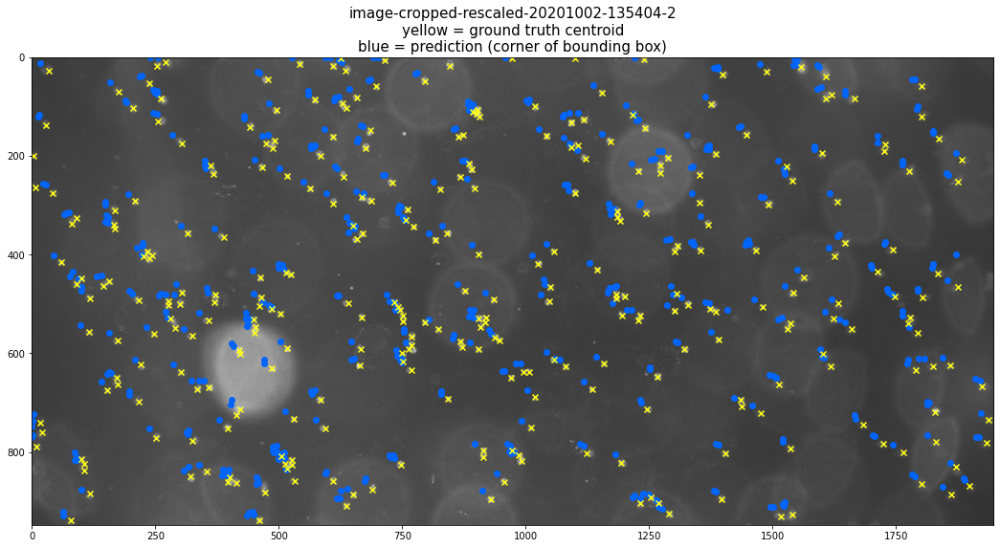

In [126]:
for name in names:
    print('\n--------------------------------------------\n')
    print(name)
    
    df_pred = pd.read_csv('./predictions/%s_predictions.csv' % name)
    im = imread('./images/%s.tif' % name)
    df_gt = pd.read_csv('./ground_truth/%s.csv' % name)

    plt.hist(df_pred.prob)
    plt.xlabel('prediction value')
    plt.ylabel('number of spots')
    plt.show()

    df_pred_filtered = df_pred[df_pred.prob > 0.98]

    print('count ground_truth:      ', len(df_gt))
    print('count prediction > 0.98: ', len(df_pred_filtered))

    plt.figure(figsize=(19, 9))
    plt.imshow(im, cmap='gray')
    plt.scatter(df_pred_filtered.xmin, df_pred_filtered.ymin, color='xkcd:bright blue')
    plt.scatter(df_gt.X, df_gt.Y, marker='x', color='xkcd:yellow')
    title = name + '\nyellow = ground truth centroid\nblue = prediction (corner of bounding box)'
    plt.title(title, fontsize=15)
    plt.show()

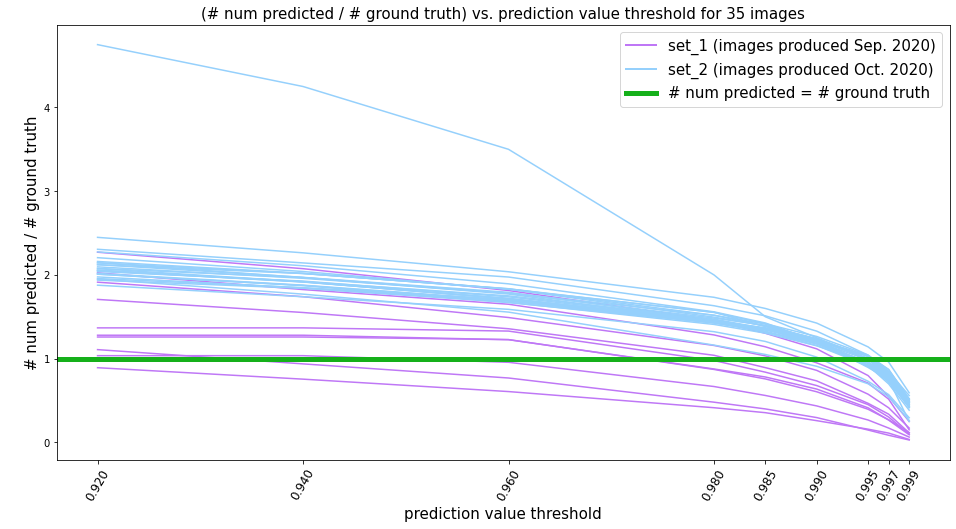

In [133]:
thresholds = [0.92, 0.94, 0.96, 0.98, 00.985, 0.99, 0.995, 0.997, 0.999]
value_dict = {}
for thresh in thresholds:
    value_dict[thresh] = 0
plt.figure(figsize=(16, 8))
for name in names:
    
    df_pred = pd.read_csv('./predictions/%s_predictions.csv' % name)
    im = imread('./images/%s.tif' % name)
    df_gt = pd.read_csv('./ground_truth/%s.csv' % name)
    num_gt = len(df_gt)
    
    values = []
    for thresh in thresholds:
        df_pred_filtered = df_pred[df_pred.prob > thresh]
        value = len(df_pred_filtered) / num_gt
        value_dict[thresh] += value
        values.append(value)
    if '202010' in name:
        color = 'xkcd:light blue'
    elif '202009' in name:
        color = 'xkcd:light purple'
    plt.plot(thresholds, values, color=color)

for key in value_dict:
    value_dict[key] = value_dict[key]/len(names)
avg_values = value_dict.values()
# plt.plot(thresholds, avg_values, color='xkcd:blue', lw=5)

plt.axhline(y=1, color='xkcd:green', linestyle='-', lw=5)
plt.xticks(thresholds, rotation=60, fontsize=12)
plt.xlabel('prediction value threshold', fontsize=15)
plt.ylabel('\n# num predicted / # ground truth', fontsize=15)
plt.title('(# num predicted / # ground truth) vs. prediction value threshold for %s images' % str(len(names)), fontsize=15)

handle_list = []
handle_list.append(Line2D([0],[0], marker=None, color='xkcd:light purple', lw=2, label='set_1 (images produced Sep. 2020)'))
handle_list.append(Line2D([0],[0], marker=None, color='xkcd:light blue', lw=2, label='set_2 (images produced Oct. 2020)'))
handle_list.append(Line2D([0],[0], marker=None, color='xkcd:green', lw=5, label='# num predicted = # ground truth'))
plt.legend(handles=handle_list, loc='upper right', fontsize=15)

plt.show()

# Takeaways

Filtering for predicted spots with a prediction value > ~0.995 results in a predicted_spot_count/actual_spot_count ratio close to 1, images that were produced in October (according to their names). This makes sense because I only trained the model on October images. I am now going through and fixing the annotations for some September images to add them to the training set. (At the time I originally annotated these, I only cared about getting counts so some of the click marks are imprecise.) Hopefully this will give more consistent performance in the September images, and hopefully further tuning of hyperparameters will tighten all the curves together.